In [1]:
!pip install torch==2.2
!pip install torch_geometric==2.4.0
!pip install seaborn==0.12.2
!pip install networkx==2.8.5
!pip install scikit-learn==1.3.2
!pip install matplotlib==3.5.2
!pip install pandas==1.4.3

  Using cached torch-2.2.0-cp312-none-macosx_11_0_arm64.whl.metadata (25 kB)
Using cached torch-2.2.0-cp312-none-macosx_11_0_arm64.whl (59.7 MB)
  Attempting uninstall: torch
    Found existing installation: torch 2.5.1
    Uninstalling torch-2.5.1:
      Successfully uninstalled torch-2.5.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchvision 0.20.1 requires torch==2.5.1, but you have torch 2.2.0 which is incompatible.
torchaudio 2.4.0 requires torch==2.4.0, but you have torch 2.2.0 which is incompatible.
  Using cached matplotlib-3.5.2.tar.gz (35.2 MB)
  Preparing metadata (setup.py) ... done
  error: subprocess-exited-with-error
  
  × python setup.py bdist_wheel did not run successfully.
  │ exit code: 1
  ╰─> [699 lines of output]
      /private/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/pip-install-8oxo4075/matplotlib_aa47c6f39fde45688040eebf3

In [2]:
import os
import torch
import numpy as np
import pandas as pd
import seaborn as sns
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.metrics import f1_score

import torch
from torch.nn import Linear
import torch.nn.functional as F
from torch_geometric.nn import GCNConv
from torch_geometric.nn import GATConv
from torch_geometric.utils import to_networkx
from torch_geometric.datasets import Planetoid

In [3]:
def visualize(data, labels):
    tsne = TSNE(n_components=2, init='pca', random_state=7)
    tsne_res = tsne.fit_transform(data)
    v = pd.DataFrame(data,columns=[str(i) for i in range(data.shape[1])])
    v['color'] = labels
    v['label'] = v['color'].apply(lambda i: str(i))
    v["dim1"] = tsne_res[:,0]
    v["dim2"] = tsne_res[:,1]
    
    plt.figure(figsize=(12,12))

    sns.scatterplot(
        x="dim1", y="dim2",
        hue="color",
        palette=sns.color_palette(["#52D1DC", "#8D0004", "#845218","#563EAA", "#E44658", "#63C100", "#FF7800"]),
        legend=False,
        data=v,
    )

In [4]:
def visualize_graph(G, color):
    plt.figure(figsize=(75,75))
    plt.xticks([])
    plt.yticks([])
    nx.draw_networkx(G, pos=nx.arf_layout(G), with_labels=False,
                     node_color=color, cmap="rainbow")
    plt.show()

In [5]:
from torch_geometric.datasets import EllipticBitcoinDataset

In [6]:
dataset = EllipticBitcoinDataset(root='data/EllipticBitcoinDataset')

In [7]:
print(f'Dataset: {dataset}:')
print('======================')
print(f'Number of graphs: {len(dataset)}')
print(f'Number of features: {dataset.num_features}')
print(f'Number of classes: {dataset.num_classes}')

Dataset: EllipticBitcoinDataset():
Number of graphs: 1
Number of features: 165
Number of classes: 2


In [8]:
data = dataset[0]

In [9]:
print(data)
print('==============================================================')

# Gather some statistics about the graph.
print(f'Number of nodes: {data.num_nodes}')
print(f'Number of edges: {data.num_edges}')
print(f'Average node degree: {data.num_edges / data.num_nodes:.2f}')
print(f'Number of training nodes: {data.train_mask.sum()}')
print(f'Training node label rate: {int(data.train_mask.sum()) / data.num_nodes:.2f}')
print(f'Has isolated nodes: {data.has_isolated_nodes()}')
print(f'Has self-loops: {data.has_self_loops()}')
print(f'Is undirected: {data.is_undirected()}')

Data(x=[203769, 165], edge_index=[2, 234355], y=[203769], train_mask=[203769], test_mask=[203769])
Number of nodes: 203769
Number of edges: 234355
Average node degree: 1.15
Number of training nodes: 29894
Training node label rate: 0.15
Has isolated nodes: False
Has self-loops: False
Is undirected: False


In [10]:
pd.value_counts(data.y.numpy())

2    157205
0     42019
1      4545
dtype: int64

In [11]:
data.train_mask.sum() + data.test_mask.sum()

tensor(46564)

In [12]:
data.y[data.train_mask].sum() + data.y[data.test_mask].sum()

tensor(4545)

In [13]:
# Ensure `train_mask` exists and is a Boolean tensor
train_mask = data.train_mask.bool()

# Determine the number of training nodes
train_indices = train_mask.nonzero(as_tuple=True)[0]

# Shuffle the training indices for random splitting
train_indices = train_indices[torch.randperm(train_indices.size(0))]

# Define the size of the validation set (e.g., 20% of the training nodes)
val_size = int(0.2 * len(train_indices))

# Split the training indices into validation and new training sets
val_indices = train_indices[:val_size]
new_train_indices = train_indices[val_size:]

# Create new masks for training and validation
new_train_mask = torch.zeros_like(train_mask)
new_val_mask = torch.zeros_like(train_mask)

new_train_mask[new_train_indices] = True
new_val_mask[val_indices] = True

# Update the data object with the new masks
data.train_mask = new_train_mask
data.val_mask = new_val_mask

# Verify the sizes of the new masks
print("Training nodes:", new_train_mask.sum().item())
print("Validation nodes:", new_val_mask.sum().item())
print("Testing nodes:", data.test_mask.sum().item())

Training nodes: 23916
Validation nodes: 5978
Testing nodes: 16670


In [14]:
data.subgraph(subset=val_indices)

Data(x=[5978, 165], edge_index=[2, 940], y=[5978], train_mask=[5978], test_mask=[5978], val_mask=[5978])

In [15]:
def visualize_graph(G, color):
    plt.figure(figsize=(60,60))
    plt.xticks([])
    plt.yticks([])
    nx.draw_networkx(G, pos=nx.random_layout(G), with_labels=False,
                     node_color=color, cmap="winter_r", arrows=True)
    plt.savefig('foo.svg')
    plt.show()

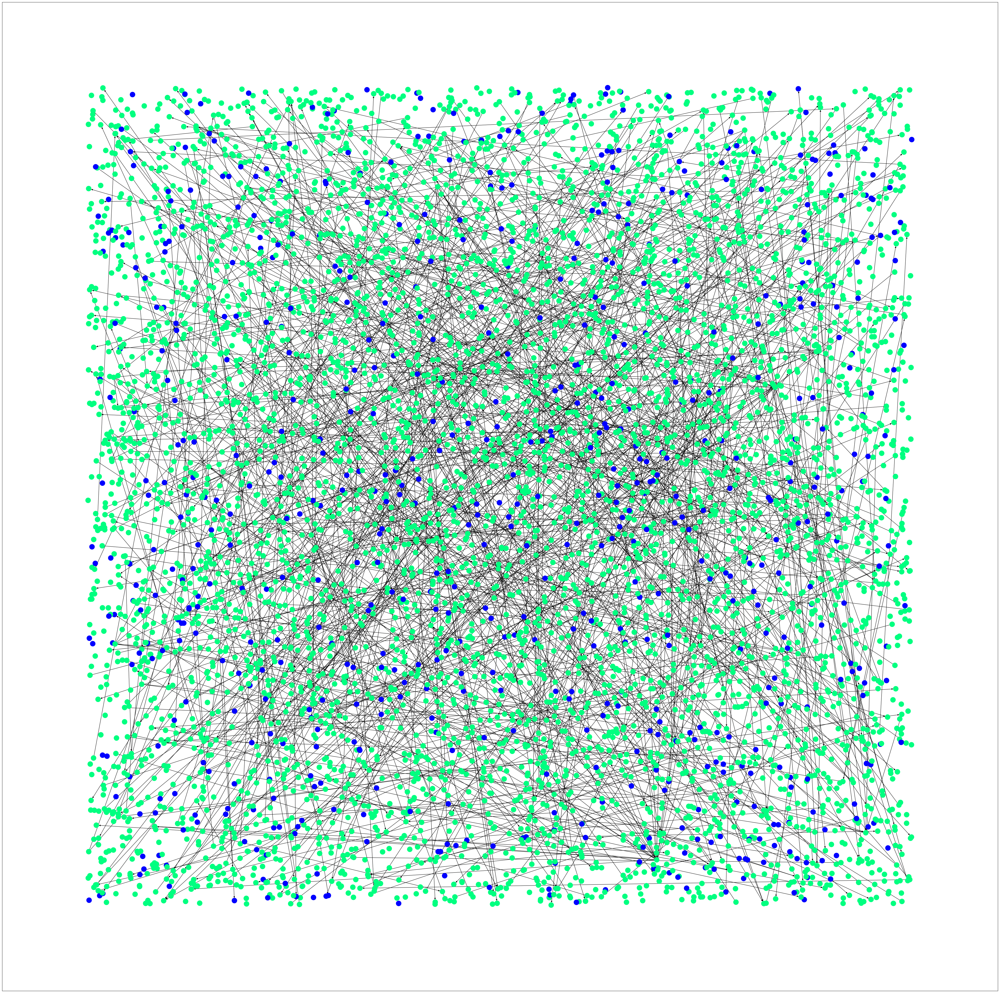

In [16]:
G = to_networkx(data.subgraph(subset=val_indices))
visualize_graph(G, color=data.subgraph(subset=val_indices).y)

In [17]:
NUM_EPOCHS = 1000
LR = 0.01
WDECAY = 1e-4

In [18]:
class MLP(torch.nn.Module):
    def __init__(self, hidden_channels):
        super().__init__()
        torch.manual_seed(12345)
        self.lin1 = Linear(dataset.num_features, hidden_channels)
        self.lin2 = Linear(hidden_channels, dataset.num_classes)

    def forward(self, x):
        x = self.lin1(x)
        x = x.relu()
        x = F.dropout(x, p=0.5, training=self.training)
        x = self.lin2(x)
        return x

model = MLP(hidden_channels=8)
print(model)

MLP(
  (lin1): Linear(in_features=165, out_features=8, bias=True)
  (lin2): Linear(in_features=8, out_features=2, bias=True)
)


/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/ipykernel_76711/2296163890.py:12: UserWarning: The palette list has more values (7) than needed (2), which may not be intended.
  sns.scatterplot(


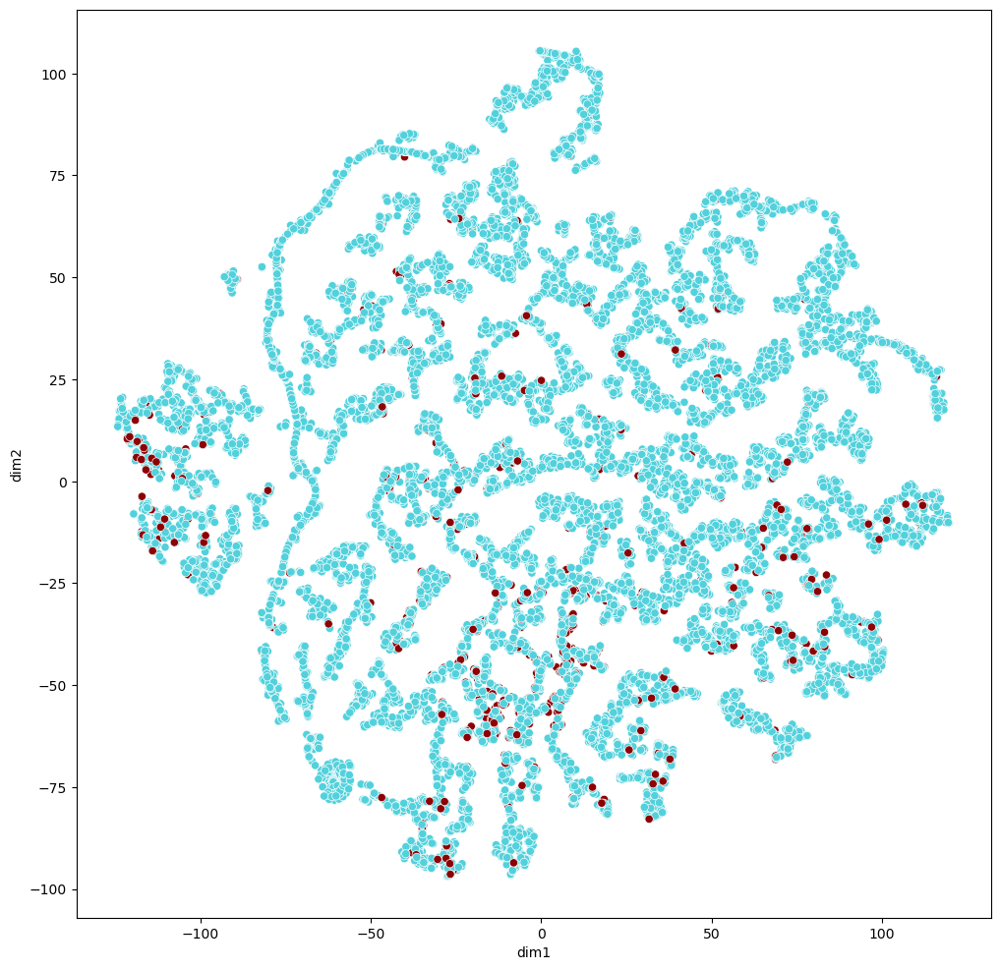

In [19]:
model.eval()
out = model(data.x[data.test_mask])
visualize(out.detach().cpu().numpy(), data.y[data.test_mask])

In [20]:
model = MLP(hidden_channels=8)
criterion = torch.nn.CrossEntropyLoss()  # Define loss criterion.
optimizer = torch.optim.Adam(model.parameters(), lr=LR, weight_decay=WDECAY)  # Define optimizer.

def train():
      model.train()
      optimizer.zero_grad()  # Clear gradients.
      out = model(data.x)  # Perform a single forward pass.
      loss = criterion(out[data.train_mask], data.y[data.train_mask])  # Compute the loss solely based on the training nodes.
      loss.backward()  # Derive gradients.
      optimizer.step()  # Update parameters based on gradients.
      return loss

def test(mask):
    model.eval()
    out = model(data.x)
    pred = out.argmax(dim=1)  # Use the class with highest probability.
    correct = pred[mask] == data.y[mask]  # Check against ground-truth labels.
    
    # Calculate accuracy
    acc = int(correct.sum()) / int(mask.sum())  # Derive ratio of correct predictions.
    
    # Calculate F1 score
    f1 = f1_score(data.y[mask].cpu(), pred[mask].cpu(), average='weighted')  # Use weighted average for multi-class
    
    return acc, f1
    

losses = []
accs = []

for epoch in range(NUM_EPOCHS):
    loss = train()
    val_acc, val_f1 = test(data.val_mask)
    losses.append(loss.detach().numpy())
    accs.append(val_acc)
    print(f'Epoch: {epoch:03d}, Loss: {loss:.4f}, Acc: {val_acc:.4f},  F1: {val_f1:.4f}')

Epoch: 000, Loss: 0.8356, Acc: 0.7109,  F1: 0.7579
Epoch: 001, Loss: 0.6479, Acc: 0.8183,  F1: 0.8330
Epoch: 002, Loss: 0.5633, Acc: 0.8479,  F1: 0.8522
Epoch: 003, Loss: 0.5153, Acc: 0.8632,  F1: 0.8604
Epoch: 004, Loss: 0.4816, Acc: 0.8742,  F1: 0.8684
Epoch: 005, Loss: 0.4548, Acc: 0.8796,  F1: 0.8723
Epoch: 006, Loss: 0.4329, Acc: 0.8856,  F1: 0.8776
Epoch: 007, Loss: 0.4120, Acc: 0.8918,  F1: 0.8827
Epoch: 008, Loss: 0.3988, Acc: 0.8993,  F1: 0.8911
Epoch: 009, Loss: 0.3798, Acc: 0.9072,  F1: 0.8993
Epoch: 010, Loss: 0.3667, Acc: 0.9154,  F1: 0.9087
Epoch: 011, Loss: 0.3548, Acc: 0.9225,  F1: 0.9165
Epoch: 012, Loss: 0.3451, Acc: 0.9276,  F1: 0.9223
Epoch: 013, Loss: 0.3362, Acc: 0.9314,  F1: 0.9268
Epoch: 014, Loss: 0.3213, Acc: 0.9338,  F1: 0.9292
Epoch: 015, Loss: 0.3202, Acc: 0.9349,  F1: 0.9307
Epoch: 016, Loss: 0.3108, Acc: 0.9364,  F1: 0.9326
Epoch: 017, Loss: 0.3010, Acc: 0.9396,  F1: 0.9361
Epoch: 018, Loss: 0.2934, Acc: 0.9411,  F1: 0.9380
Epoch: 019, Loss: 0.2923, Acc: 

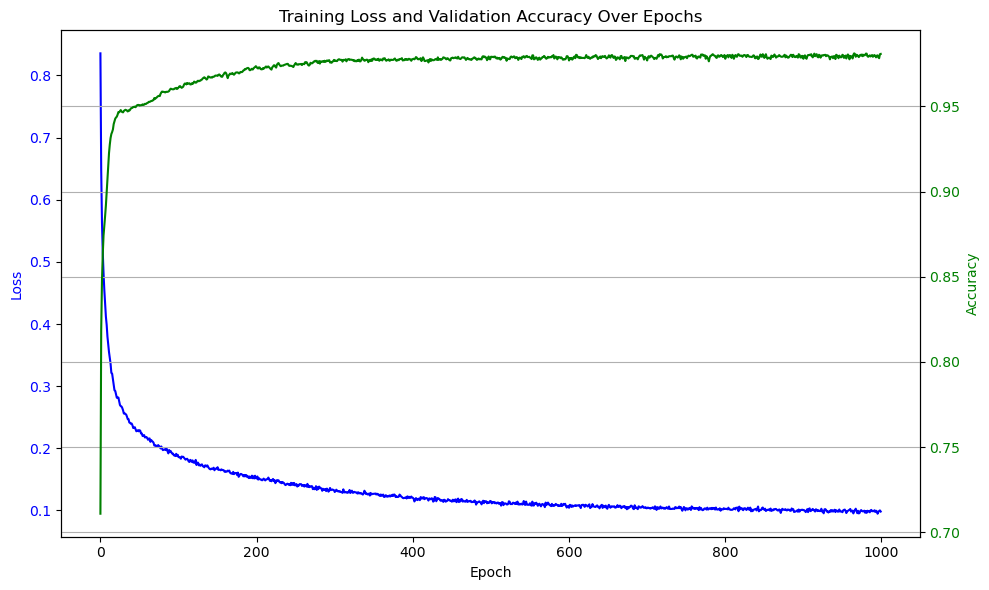

In [21]:
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plot training loss
ax1.plot(range(NUM_EPOCHS), losses, label='Training Loss', color='blue')
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Loss', color='blue')
ax1.tick_params(axis='y', labelcolor='blue')

# Create a second y-axis for validation accuracy
ax2 = ax1.twinx()
ax2.plot(range(NUM_EPOCHS), accs, label='Validation Accuracy', color='green')
ax2.set_ylabel('Accuracy', color='green')
ax2.tick_params(axis='y', labelcolor='green')

# Add a title and grid
plt.title('Training Loss and Validation Accuracy Over Epochs')
fig.tight_layout()
plt.grid(True)

# Show the plot
plt.show()

In [22]:
test_acc, test_f1 = test(data.test_mask)
print(f'Test Accuracy: {test_acc:.4f}, F1-Score: {test_f1:.4f}')

Test Accuracy: 0.9328, F1-Score: 0.9377


/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/ipykernel_76711/2296163890.py:12: UserWarning: The palette list has more values (7) than needed (2), which may not be intended.
  sns.scatterplot(


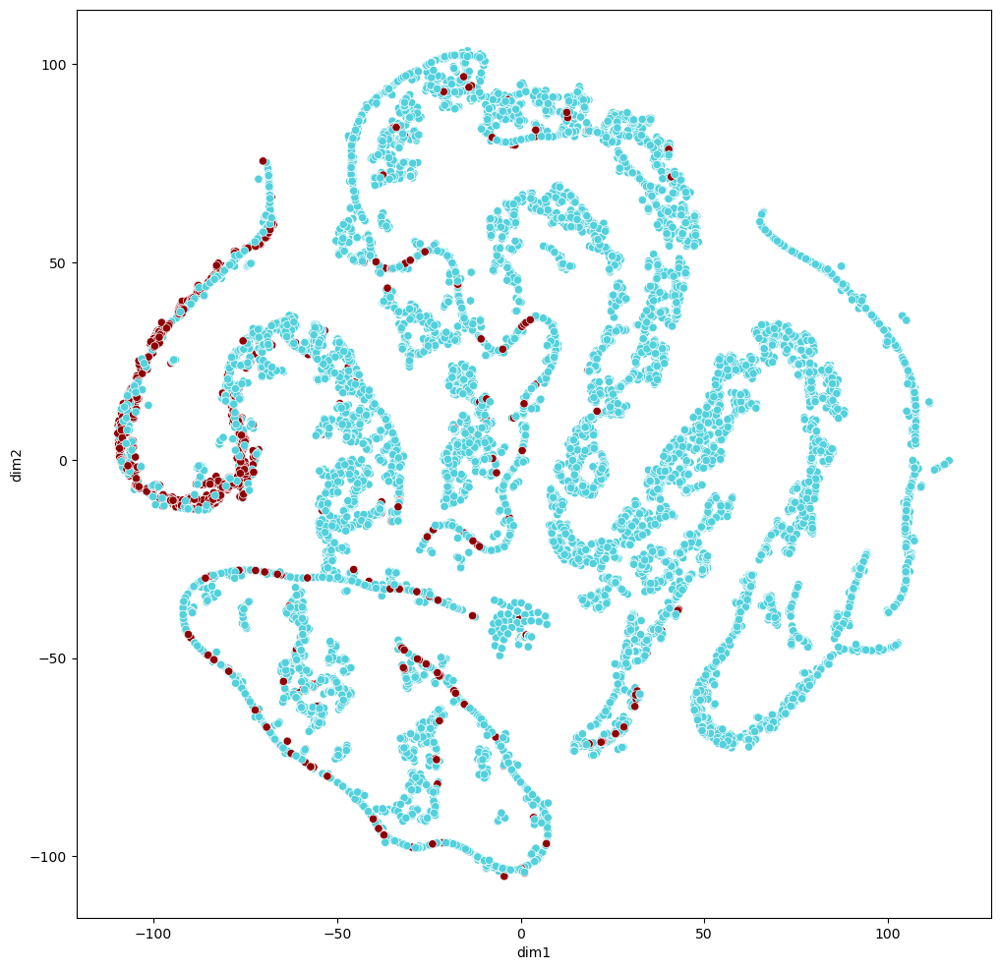

In [23]:
model.eval()
out = model(data.x[data.test_mask])
visualize(out.detach().cpu().numpy(), data.y[data.test_mask])

# ========================================

In [25]:
class GCN(torch.nn.Module):
    def __init__(self, hidden_channels):
        super().__init__()
        torch.manual_seed(1234567)
        self.conv1 = GCNConv(dataset.num_features, hidden_channels)
        self.conv2 = GCNConv(hidden_channels, dataset.num_classes)

    def forward(self, x, edge_index):
        x = self.conv1(x, edge_index)
        x = x.relu()
        x = F.dropout(x, p=0.5, training=self.training)
        x = self.conv2(x, edge_index)
        return x

model = GCN(hidden_channels=8)
print(model)

GCN(
  (conv1): GCNConv(165, 8)
  (conv2): GCNConv(8, 2)
)


/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/ipykernel_76711/2296163890.py:12: UserWarning: The palette list has more values (7) than needed (2), which may not be intended.
  sns.scatterplot(


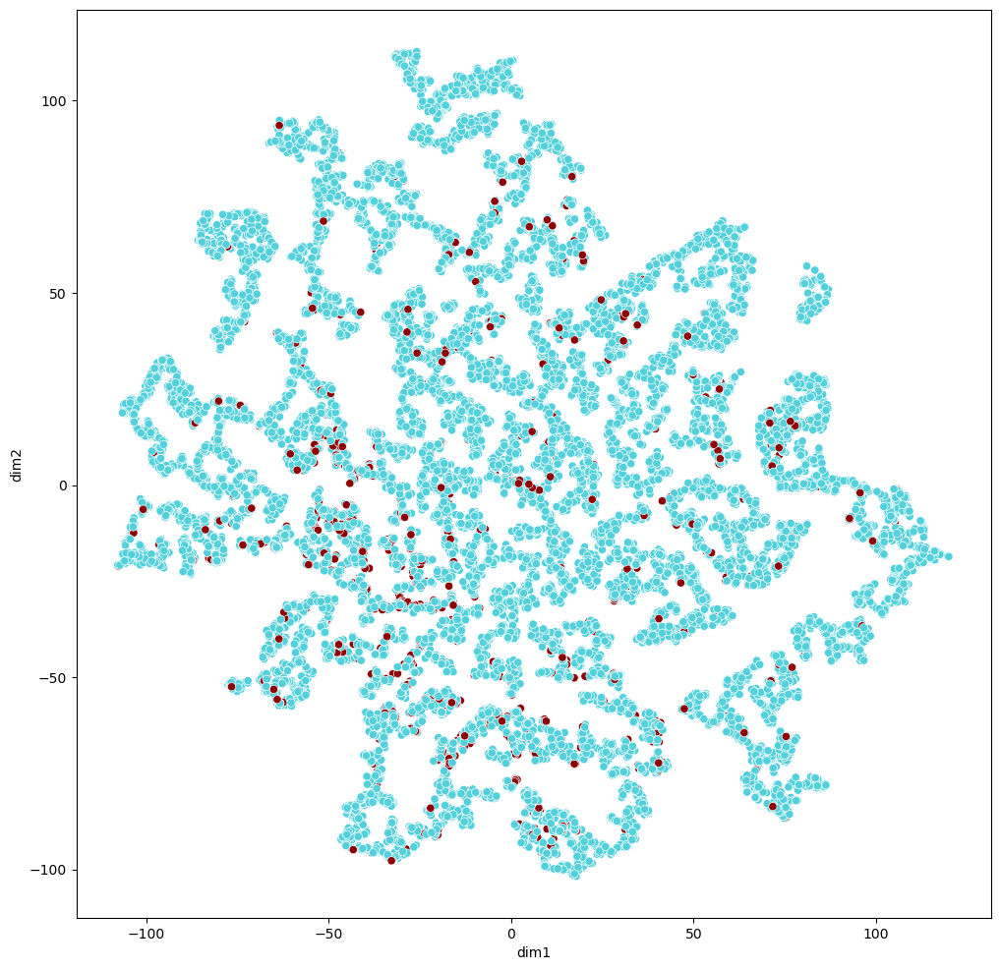

In [26]:
# Ensure the test_mask is a Boolean tensor
test_mask = data.test_mask.bool()  # Nodes in the test set
test_nodes = test_mask.nonzero(as_tuple=True)[0]  # Indices of test nodes

# Create a mapping from global node indices to local indices
node_map = {node.item(): i for i, node in enumerate(test_nodes)}

# Filter edges where both source and target nodes are in the test set
edge_mask = test_mask[data.edge_index[0]] & test_mask[data.edge_index[1]]
test_edge_index = data.edge_index[:, edge_mask]

# Reindex edges to use local node indices
test_edge_index = torch.tensor(
    [[node_map[src.item()], node_map[tgt.item()]]
     for src, tgt in zip(test_edge_index[0], test_edge_index[1])],
    dtype=torch.long
).T

# Filter node features and labels for the test set
test_x = data.x[test_mask]  # Node features for the test nodes
test_y = data.y[test_mask]  # Labels for the test nodes

# Pass the filtered and reindexed data into the model
model.eval()
out = model(test_x, test_edge_index)

# Visualize the output
visualize(out.detach().cpu().numpy(), test_y)

In [27]:
model = GCN(hidden_channels=8)
optimizer = torch.optim.Adam(model.parameters(), lr=LR, weight_decay=WDECAY)
criterion = torch.nn.CrossEntropyLoss()

def train():
      model.train()
      optimizer.zero_grad()  # Clear gradients.
      out = model(data.x, data.edge_index)  # Perform a single forward pass.
      loss = criterion(out[data.train_mask], data.y[data.train_mask])  # Compute the loss solely based on the training nodes.
      loss.backward()  # Derive gradients.
      optimizer.step()  # Update parameters based on gradients.
      return loss

def test(mask):
    model.eval()
    out = model(data.x, data.edge_index)  # Forward pass through the model
    pred = out.argmax(dim=1)  # Use the class with highest probability
    correct = pred[mask] == data.y[mask]  # Check against ground-truth labels
    acc = int(correct.sum()) / int(mask.sum())  # Derive ratio of correct predictions
    
    # Calculate precision and recall using sklearn
    y_true = data.y[mask].cpu().numpy()  # Ground truth labels
    y_pred = pred[mask].cpu().numpy()  # Predicted labels
    
    # Calculate F1 score
    f1 = f1_score(y_true, y_pred, average='weighted')  # Use weighted average for multi-class
    
    return acc, f1  # Return accuracy and F1 score


losses = []
accs = []

for epoch in range(NUM_EPOCHS):
    loss = train()
    val_acc, val_f1 = test(data.val_mask)
    losses.append(loss.detach().numpy())
    accs.append(val_acc)
    print(f'Epoch: {epoch:03d}, Loss: {loss:.4f}, Acc: {val_acc:.4f},  F1: {val_f1:.4f}')

Epoch: 000, Loss: 1.0863, Acc: 0.7827,  F1: 0.8058
Epoch: 001, Loss: 0.5860, Acc: 0.8247,  F1: 0.8363
Epoch: 002, Loss: 0.4586, Acc: 0.8483,  F1: 0.8539
Epoch: 003, Loss: 0.4056, Acc: 0.8652,  F1: 0.8664
Epoch: 004, Loss: 0.3659, Acc: 0.8732,  F1: 0.8725
Epoch: 005, Loss: 0.3547, Acc: 0.8762,  F1: 0.8744
Epoch: 006, Loss: 0.3357, Acc: 0.8794,  F1: 0.8767
Epoch: 007, Loss: 0.3223, Acc: 0.8826,  F1: 0.8789
Epoch: 008, Loss: 0.3186, Acc: 0.8871,  F1: 0.8825
Epoch: 009, Loss: 0.3114, Acc: 0.8884,  F1: 0.8834
Epoch: 010, Loss: 0.3069, Acc: 0.8914,  F1: 0.8872
Epoch: 011, Loss: 0.3015, Acc: 0.8939,  F1: 0.8895
Epoch: 012, Loss: 0.2994, Acc: 0.8956,  F1: 0.8908
Epoch: 013, Loss: 0.3038, Acc: 0.8971,  F1: 0.8916
Epoch: 014, Loss: 0.2997, Acc: 0.8998,  F1: 0.8940
Epoch: 015, Loss: 0.2924, Acc: 0.9006,  F1: 0.8946
Epoch: 016, Loss: 0.2915, Acc: 0.9008,  F1: 0.8944
Epoch: 017, Loss: 0.2922, Acc: 0.9028,  F1: 0.8960
Epoch: 018, Loss: 0.2843, Acc: 0.9038,  F1: 0.8965
Epoch: 019, Loss: 0.2801, Acc: 

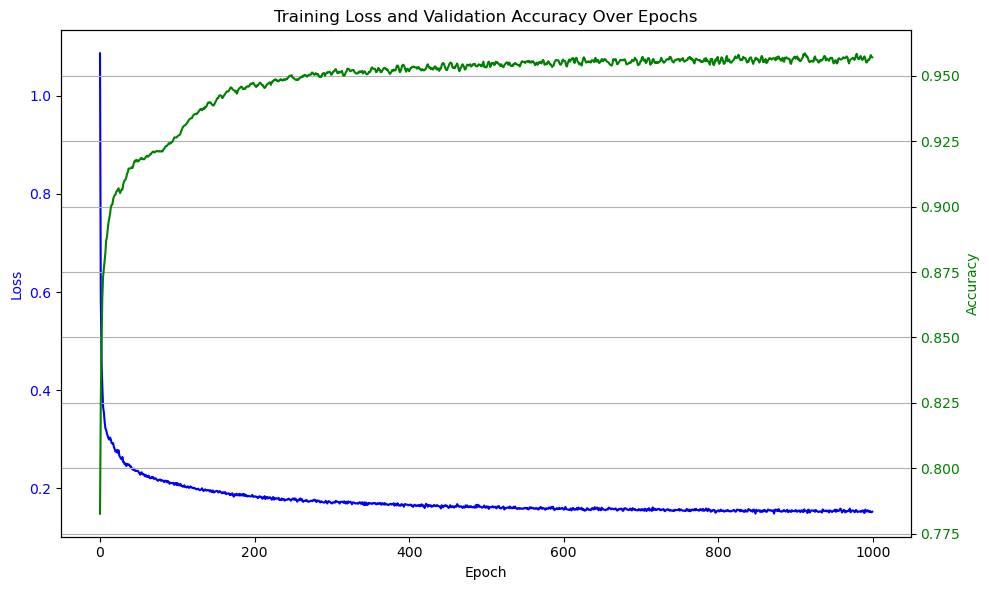

In [28]:
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plot training loss
ax1.plot(range(NUM_EPOCHS), losses, label='Training Loss', color='blue')
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Loss', color='blue')
ax1.tick_params(axis='y', labelcolor='blue')

# Create a second y-axis for validation accuracy
ax2 = ax1.twinx()
ax2.plot(range(NUM_EPOCHS), accs, label='Validation Accuracy', color='green')
ax2.set_ylabel('Accuracy', color='green')
ax2.tick_params(axis='y', labelcolor='green')

# Add a title and grid
plt.title('Training Loss and Validation Accuracy Over Epochs')
fig.tight_layout()
plt.grid(True)

# Show the plot
plt.show()

In [29]:
test_acc, test_f1 = test(data.test_mask)
print(f'Test Accuracy: {test_acc:.4f}, F1-Score: {test_f1:.4f}')

Test Accuracy: 0.9467, F1-Score: 0.9403


/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/ipykernel_76711/2296163890.py:12: UserWarning: The palette list has more values (7) than needed (2), which may not be intended.
  sns.scatterplot(


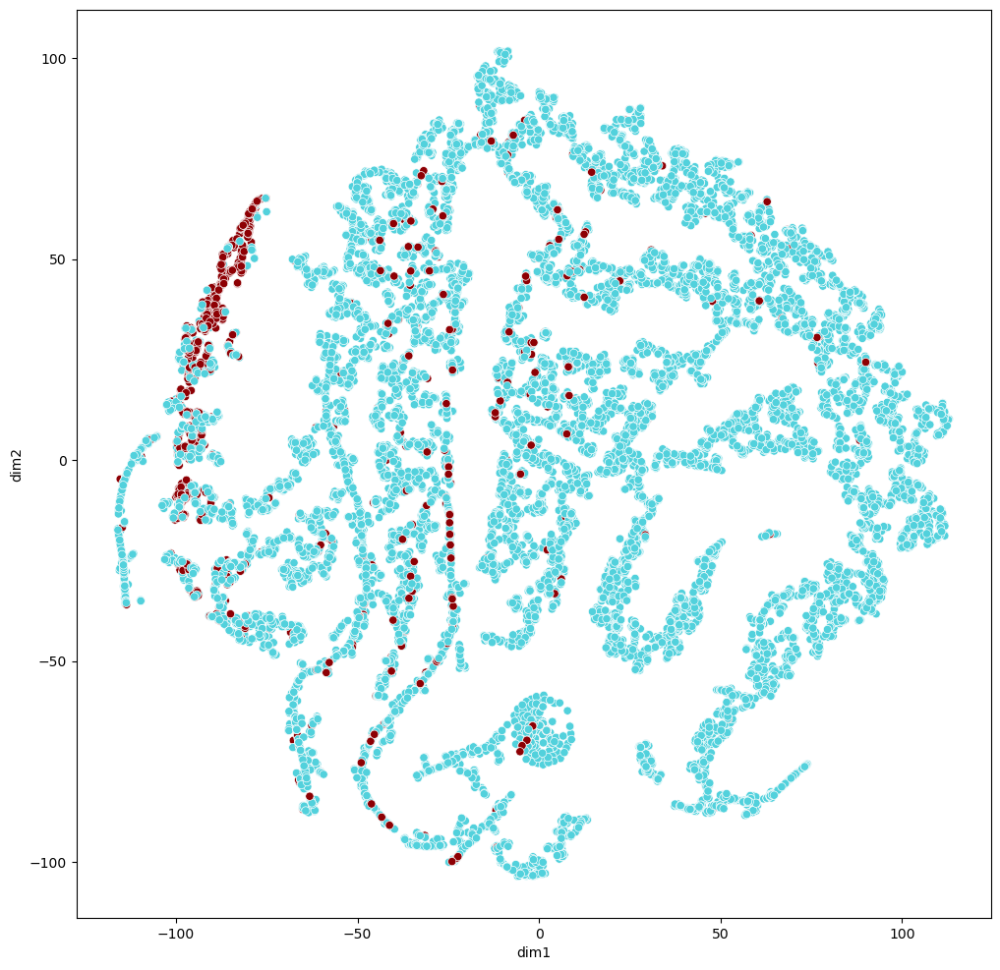

In [30]:
# Pass the filtered and reindexed data into the model
model.eval()
out = model(test_x, test_edge_index)
# Visualize the output
visualize(out.detach().cpu().numpy(), test_y)

# ========================================

In [32]:
class GAT(torch.nn.Module):
    def __init__(self, hidden_channels, heads):
        super().__init__()
        torch.manual_seed(1234567)
        self.conv1 = GATConv(dataset.num_features, hidden_channels, heads)
        self.conv2 = GATConv(hidden_channels * heads, dataset.num_classes, heads=1)

    def forward(self, x, edge_index):
        x = F.dropout(x, p=0.5, training=self.training)
        x = self.conv1(x, edge_index)
        x = F.relu(x)
        x = F.dropout(x, p=0.5, training=self.training)
        x = self.conv2(x, edge_index)
        return x

model = GAT(hidden_channels=8, heads=4)
print(model)

GAT(
  (conv1): GATConv(165, 8, heads=4)
  (conv2): GATConv(32, 2, heads=1)
)


/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/ipykernel_76711/2296163890.py:12: UserWarning: The palette list has more values (7) than needed (2), which may not be intended.
  sns.scatterplot(


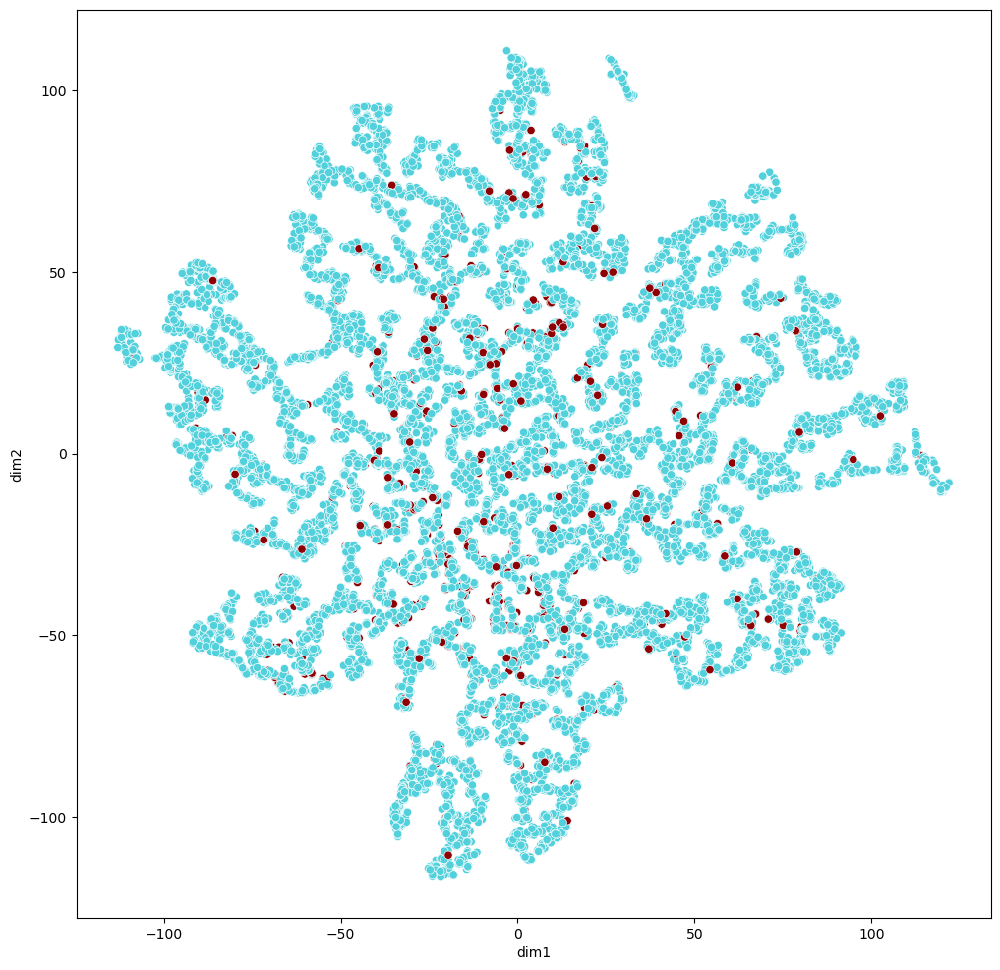

In [33]:
# Ensure the test_mask is a Boolean tensor
test_mask = data.test_mask.bool()  # Nodes in the test set
test_nodes = test_mask.nonzero(as_tuple=True)[0]  # Indices of test nodes

# Create a mapping from global node indices to local indices
node_map = {node.item(): i for i, node in enumerate(test_nodes)}

# Filter edges where both source and target nodes are in the test set
edge_mask = test_mask[data.edge_index[0]] & test_mask[data.edge_index[1]]
test_edge_index = data.edge_index[:, edge_mask]

# Reindex edges to use local node indices
test_edge_index = torch.tensor(
    [[node_map[src.item()], node_map[tgt.item()]]
     for src, tgt in zip(test_edge_index[0], test_edge_index[1])],
    dtype=torch.long
).T

# Filter node features and labels for the test set
test_x = data.x[test_mask]  # Node features for the test nodes
test_y = data.y[test_mask]  # Labels for the test nodes

# Pass the filtered and reindexed data into the model
model.eval()
out = model(test_x, test_edge_index)

# Visualize the output
visualize(out.detach().cpu().numpy(), test_y)

In [34]:
model = GAT(hidden_channels=8, heads=4)
optimizer = torch.optim.Adam(model.parameters(), lr=LR, weight_decay=WDECAY)
criterion = torch.nn.CrossEntropyLoss()

def train():
      model.train()
      optimizer.zero_grad()  # Clear gradients.
      out = model(data.x, data.edge_index)  # Perform a single forward pass.
      loss = criterion(out[data.train_mask], data.y[data.train_mask])  # Compute the loss solely based on the training nodes.
      loss.backward()  # Derive gradients.
      optimizer.step()  # Update parameters based on gradients.
      return loss

def test(mask):
    model.eval()
    out = model(data.x, data.edge_index)  # Forward pass through the model
    pred = out.argmax(dim=1)  # Use the class with highest probability
    correct = pred[mask] == data.y[mask]  # Check against ground-truth labels
    acc = int(correct.sum()) / int(mask.sum())  # Derive ratio of correct predictions
    
    # Calculate precision and recall using sklearn
    y_true = data.y[mask].cpu().numpy()  # Ground truth labels
    y_pred = pred[mask].cpu().numpy()  # Predicted labels
    
    # Calculate F1 score
    f1 = f1_score(y_true, y_pred, average='weighted')  # Use weighted average for multi-class
    
    return acc, f1  # Return accuracy and F1 score


losses = []
accs = []

for epoch in range(NUM_EPOCHS):
    loss = train()
    val_acc, val_f1 = test(data.val_mask)
    losses.append(loss.detach().numpy())
    accs.append(val_acc)
    print(f'Epoch: {epoch:03d}, Loss: {loss:.4f}, Acc: {val_acc:.4f},  F1: {val_f1:.4f}')

Epoch: 000, Loss: 1.6660, Acc: 0.8011,  F1: 0.8204
Epoch: 001, Loss: 0.9502, Acc: 0.8623,  F1: 0.8636
Epoch: 002, Loss: 0.4717, Acc: 0.8812,  F1: 0.8764
Epoch: 003, Loss: 0.5208, Acc: 0.8881,  F1: 0.8814
Epoch: 004, Loss: 0.3802, Acc: 0.8906,  F1: 0.8830
Epoch: 005, Loss: 0.3759, Acc: 0.8923,  F1: 0.8843
Epoch: 006, Loss: 0.3640, Acc: 0.8948,  F1: 0.8866
Epoch: 007, Loss: 0.3638, Acc: 0.9005,  F1: 0.8936
Epoch: 008, Loss: 0.3679, Acc: 0.9036,  F1: 0.8978
Epoch: 009, Loss: 0.3547, Acc: 0.9078,  F1: 0.9035
Epoch: 010, Loss: 0.3567, Acc: 0.9115,  F1: 0.9088
Epoch: 011, Loss: 0.3559, Acc: 0.9139,  F1: 0.9118
Epoch: 012, Loss: 0.3383, Acc: 0.9155,  F1: 0.9143
Epoch: 013, Loss: 0.3264, Acc: 0.9190,  F1: 0.9184
Epoch: 014, Loss: 0.3189, Acc: 0.9224,  F1: 0.9218
Epoch: 015, Loss: 0.3133, Acc: 0.9241,  F1: 0.9237
Epoch: 016, Loss: 0.2930, Acc: 0.9251,  F1: 0.9245
Epoch: 017, Loss: 0.2948, Acc: 0.9264,  F1: 0.9258
Epoch: 018, Loss: 0.2861, Acc: 0.9287,  F1: 0.9276
Epoch: 019, Loss: 0.2839, Acc: 

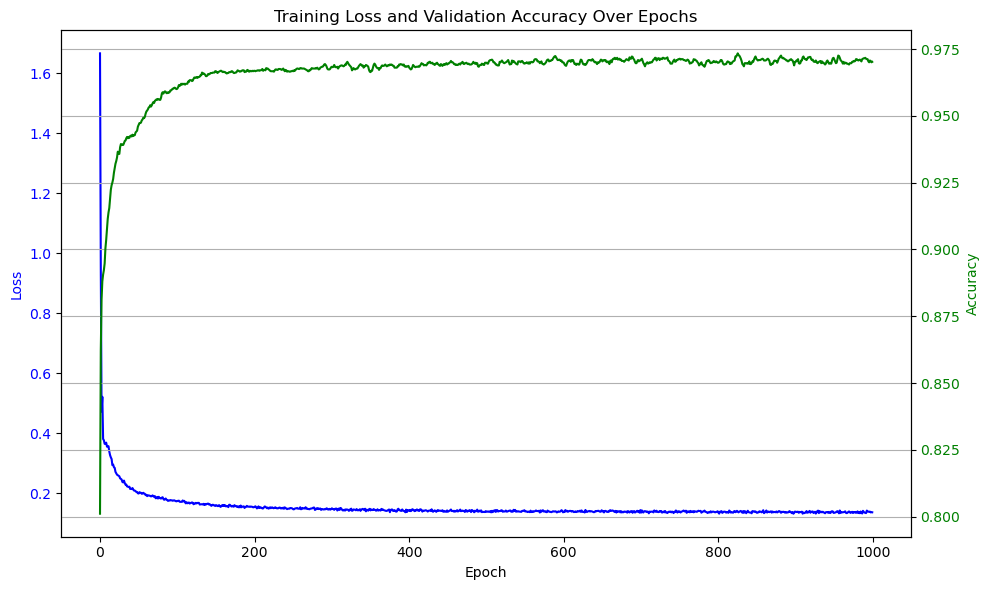

In [35]:
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plot training loss
ax1.plot(range(NUM_EPOCHS), losses, label='Training Loss', color='blue')
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Loss', color='blue')
ax1.tick_params(axis='y', labelcolor='blue')

# Create a second y-axis for validation accuracy
ax2 = ax1.twinx()
ax2.plot(range(NUM_EPOCHS), accs, label='Validation Accuracy', color='green')
ax2.set_ylabel('Accuracy', color='green')
ax2.tick_params(axis='y', labelcolor='green')

# Add a title and grid
plt.title('Training Loss and Validation Accuracy Over Epochs')
fig.tight_layout()
plt.grid(True)

# Show the plot
plt.show()

In [36]:
test_acc, test_f1 = test(data.test_mask)
print(f'Test Accuracy: {test_acc:.4f}, F1-Score: {test_f1:.4f}')

Test Accuracy: 0.9574, F1-Score: 0.9546


/var/folders/4v/h808km254mb5ws5bw0w90t240000gn/T/ipykernel_76711/2296163890.py:12: UserWarning: The palette list has more values (7) than needed (2), which may not be intended.
  sns.scatterplot(


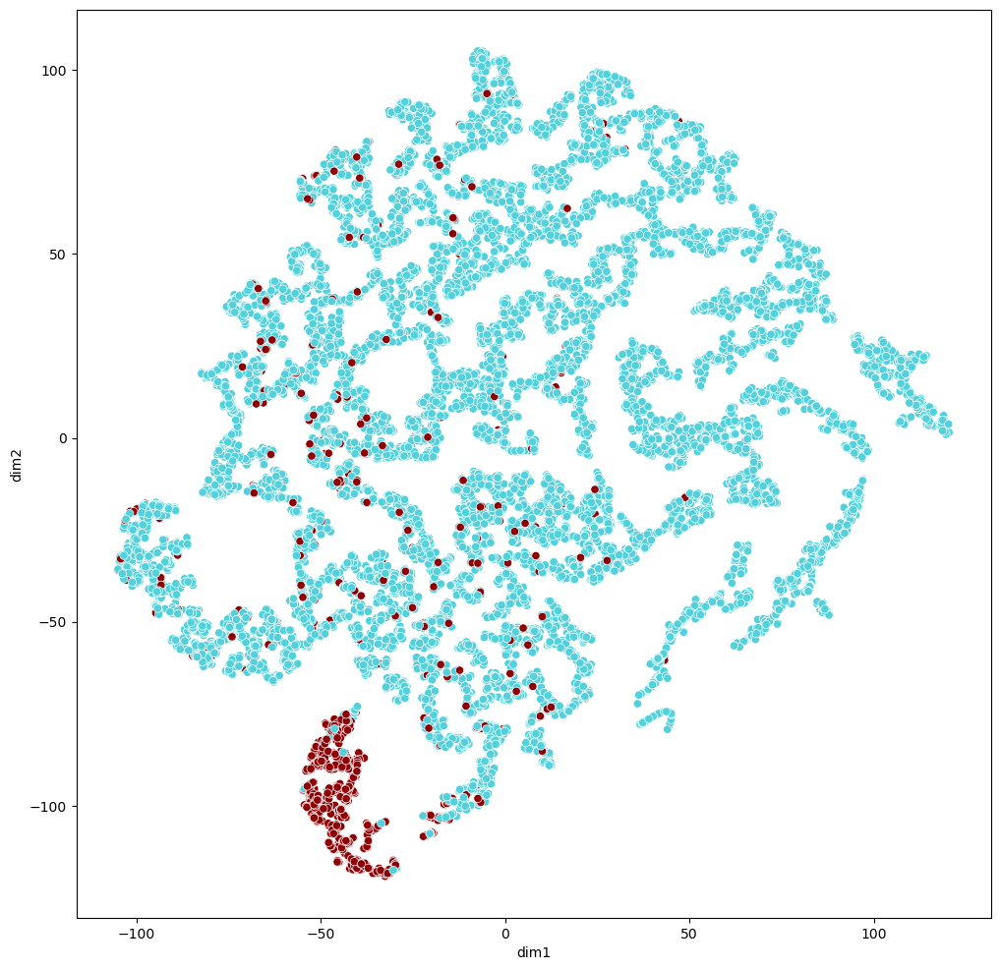

In [37]:
# Pass the filtered and reindexed data into the model
model.eval()
out = model(test_x, test_edge_index)

# Visualize the output
visualize(out.detach().cpu().numpy(), test_y)